In [1]:
import pandas as pd
import numpy as np
import os
import seaborn as sns

In [2]:
%matplotlib inline
import matplotlib.pyplot as plt

In [3]:
def check_null(df):
    if df.isna().sum().sum()==0:
        return 0
    else:
        return 1

In [4]:
data_folder_name='Data'

In [5]:
file_names=os.listdir('Data')

In [6]:
imports=[]
for file in file_names:
    imports.append(data_folder_name+"/"+file)

In [7]:
print(imports)

['Data/RUL_FD001.txt', 'Data/RUL_FD002.txt', 'Data/RUL_FD003.txt', 'Data/RUL_FD004.txt', 'Data/test_FD001.txt', 'Data/test_FD002.txt', 'Data/test_FD003.txt', 'Data/test_FD004.txt', 'Data/train_FD001.txt', 'Data/train_FD002.txt', 'Data/train_FD003.txt', 'Data/train_FD004.txt']


In [8]:
index_names = ['Engine', 'Cycle']
setting_names = ['Setting 1', 'Setting 2', 'Setting 3']
sensor_names=[ 
"(Fan Inlet Temperature) (◦R)",
"(LPC Outlet Temperature) (◦R)",
"(HPC Outlet Temperature) (◦R)",
"(LPT Outlet Temperature) (◦R)",
"(Fan Inlet Pressure) (psia)",
"(Bypass-Duct Pressure) (psia)",
"(HPC Outlet Pressure) (psia)",
"(Physical Fan Speed) (rpm)",
"(Physical Core Speed) (rpm)",
"(Engine Pressure Ratio(P50/P2)",
"(HPC Outlet Static Pressure) (psia)",
"(Ratio of Fuel Flow to Ps30) (pps/psia)",
"(Corrected Fan Speed) (rpm)",
"(Corrected Core Speed) (rpm)",
"(Bypass Ratio) ",
"(Burner Fuel-Air Ratio)",
"(Bleed Enthalpy)",
"(Demanded Fan Speed) (rpm)",
"(Demanded Corrected Fan Speed) (rpm)",
"(HPT Coolant Bleed) (lbm/s)",
"(Low-Pressure Turbines Cool Air Flow) (lbm/s)",
"Sensor 26",
"Sensor 27"]
col_names = index_names + setting_names + sensor_names

Importing 1 train data set

In [9]:
train1=pd.read_csv(imports[8],sep=' ',header=None)

In [10]:
train1.head()

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,25,26,27
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,NaN,NaN
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,NaN,NaN
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,NaN,NaN
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,NaN,NaN
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,NaN,NaN


In [47]:
train1.columns=col_names
train1.drop(columns=["Sensor 26", "Sensor 27"], inplace=True)

ValueError: Length mismatch: Expected axis has 27 elements, new values have 28 elements

In [ ]:
train1.head()

In [13]:
train1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20631 entries, 0 to 20630
Data columns (total 26 columns):
 #   Column                                         Non-Null Count  Dtype  
---  ------                                         --------------  -----  
 0   Engine                                         20631 non-null  int64  
 1   Cycle                                          20631 non-null  int64  
 2   Setting 1                                      20631 non-null  float64
 3   Setting 2                                      20631 non-null  float64
 4   Setting 3                                      20631 non-null  float64
 5   (Fan Inlet Temperature) (◦R)                   20631 non-null  float64
 6   (LPC Outlet Temperature) (◦R)                  20631 non-null  float64
 7   (HPC Outlet Temperature) (◦R)                  20631 non-null  float64
 8   (LPT Outlet Temperature) (◦R)                  20631 non-null  float64
 9   (Fan Inlet Pressure) (psia)                    206

In [14]:
train1.describe().T

,count,mean,std,min,25%,50%,75%,max
Engine,20631.0,51.506568,2.922763e+01,1.0000,26.0000,52.0000,77.0000,100.0000
Cycle,20631.0,108.807862,6.888099e+01,1.0000,52.0000,104.0000,156.0000,362.0000
Setting 1,20631.0,-0.000009,2.187313e-03,-0.0087,-0.0015,0.0000,0.0015,0.0087
Setting 2,20631.0,0.000002,2.930621e-04,-0.0006,-0.0002,0.0000,0.0003,0.0006
Setting 3,20631.0,100.000000,0.000000e+00,100.0000,100.0000,100.0000,100.0000,100.0000
(Fan Inlet Temperature) (◦R),20631.0,518.670000,6.537152e-11,518.6700,518.6700,518.6700,518.6700,518.6700
(LPC Outlet Temperature) (◦R),20631.0,642.680934,5.000533e-01,641.2100,642.3250,642.6400,643.0000,644.5300
(HPC Outlet Temperature) (◦R),20631.0,1590.523119,6.131150e+00,1571.0400,1586.2600,1590.1000,1594.3800,1616.9100
(LPT Outlet Temperature) (◦R),20631.0,1408.933782,9.000605e+00,1382.2500,1402.3600,1408.0400,1414.5550,1441.4900
(Fan Inlet Pressure) (psia),20631.0,14.620000,3.394700e-12,14.6200,14.6200,14.6200,14.6200,14.6200


In [15]:
check_null(train1)

0

In [16]:
train1.shape

(20631, 26)

In [17]:
train1.nunique()

Engine                                            100
Cycle                                             362
Setting 1                                         158
Setting 2                                          13
Setting 3                                           1
(Fan Inlet Temperature) (◦R)                        1
(LPC Outlet Temperature) (◦R)                     310
(HPC Outlet Temperature) (◦R)                    3012
(LPT Outlet Temperature) (◦R)                    4051
(Fan Inlet Pressure) (psia)                         1
(Bypass-Duct Pressure) (psia)                       2
(HPC Outlet Pressure) (psia)                      513
(Physical Fan Speed) (rpm)                         53
(Physical Core Speed) (rpm)                      6403
(Engine Pressure Ratio(P50/P2)                      1
(HPC Outlet Static Pressure) (psia)               159
(Ratio of Fuel Flow to Ps30) (pps/psia)           427
(Corrected Fan Speed) (rpm)                        56
(Corrected Core Speed) (rpm)

###### messing around with engine 1

In [18]:
engine2=train1.query("Engine==2")

In [19]:
engine2.head(20)

,Engine,Cycle,Setting 1,Setting 2,Setting 3,(Fan Inlet Temperature) (◦R),(LPC Outlet Temperature) (◦R),(HPC Outlet Temperature) (◦R),(LPT Outlet Temperature) (◦R),(Fan Inlet Pressure) (psia),...,(Ratio of Fuel Flow to Ps30) (pps/psia),(Corrected Fan Speed) (rpm),(Corrected Core Speed) (rpm),(Bypass Ratio),(Burner Fuel-Air Ratio),(Bleed Enthalpy),(Demanded Fan Speed) (rpm),(Demanded Corrected Fan Speed) (rpm),(HPT Coolant Bleed) (lbm/s),(Low-Pressure Turbines Cool Air Flow) (lbm/s)
192,2,1,-0.0018,0.0006,100.0,518.67,641.89,1583.84,1391.28,14.62,...,522.33,2388.06,8137.72,8.3905,0.03,391,2388,100.0,38.94,23.4585
193,2,2,0.0043,-0.0003,100.0,518.67,641.82,1587.05,1393.13,14.62,...,522.70,2387.98,8131.09,8.4167,0.03,392,2388,100.0,39.06,23.4085
194,2,3,0.0018,0.0003,100.0,518.67,641.55,1588.32,1398.96,14.62,...,522.58,2387.99,8140.58,8.3802,0.03,391,2388,100.0,39.11,23.4250
195,2,4,0.0035,-0.0004,100.0,518.67,641.68,1584.15,1396.08,14.62,...,522.49,2387.93,8140.44,8.4018,0.03,391,2388,100.0,39.13,23.5027
196,2,5,0.0005,0.0004,100.0,518.67,641.73,1579.03,1402.52,14.62,...,522.27,2387.94,8136.67,8.3867,0.03,390,2388,100.0,39.18,23.4234
197,2,6,-0.0010,0.0004,100.0,518.67,641.30,1577.50,1396.76,14.62,...,522.80,2387.99,8133.65,8.3800,0.03,392,2388,100.0,39.15,23.4270
198,2,7,0.0001,-0.0002,100.0,518.67,642.03,1587.49,1400.65,14.62,...,522.14,2388.04,8136.33,8.3941,0.03,391,2388,100.0,39.10,23.4718
199,2,8,0.0015,-0.0004,100.0,518.67,642.55,1590.41,1395.39,14.62,...,522.77,2387.96,8137.92,8.3861,0.03,391,2388,100.0,39.11,23.4381
200,2,9,0.0017,-0.0004,100.0,518.67,641.98,1581.99,1395.01,14.62,...,522.40,2387.98,8145.29,8.3868,0.03,390,2388,100.0,39.06,23.4875
201,2,10,-0.0045,0.0002,100.0,518.67,641.99,1586.37,1394.86,14.62,...,521.99,2387.97,8138.64,8.3982,0.03,391,2388,100.0,39.20,23.6005


In [20]:
engine2.shape

(287, 26)

In [21]:
import ydata_profiling

In [22]:
from ydata_profiling import ProfileReport

In [23]:
%%time
profile = ProfileReport(train1,
                        title="Predictive Maintenance",
                        dataset={"description": "Set1",
                                 "copyright_holder": "Jan Toczko",
                                 "copyright_year": "2023",
                                },
                        explorative=True,
                       )
profile

CPU times: total: 0 ns
Wall time: 29 ms


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [24]:
max_cycle=train1.groupby(['Engine']).agg({'Cycle':'max'})

In [25]:
max_cycle.rename(columns={"Cycle":'Life'},inplace=True)

In [26]:
max_cycle.head()

,Life
Engine,
1,192
2,287
3,179
4,189
5,269


In [27]:
train1=train1.merge(max_cycle['Life'], on='Engine',how='left')

In [28]:
train1.head()

,Engine,Cycle,Setting 1,Setting 2,Setting 3,(Fan Inlet Temperature) (◦R),(LPC Outlet Temperature) (◦R),(HPC Outlet Temperature) (◦R),(LPT Outlet Temperature) (◦R),(Fan Inlet Pressure) (psia),...,(Corrected Fan Speed) (rpm),(Corrected Core Speed) (rpm),(Bypass Ratio),(Burner Fuel-Air Ratio),(Bleed Enthalpy),(Demanded Fan Speed) (rpm),(Demanded Corrected Fan Speed) (rpm),(HPT Coolant Bleed) (lbm/s),(Low-Pressure Turbines Cool Air Flow) (lbm/s),Life
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,192
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,192
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,192
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,192
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,192


<BarContainer object of 100 artists>

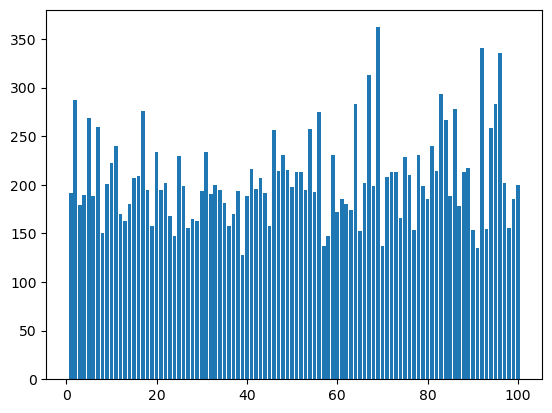

In [29]:
plt.bar(max_cycle.index, max_cycle['Life'])

In [30]:
max_cycle.index

Int64Index([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
             14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
             27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
             40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
             53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
             66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
             79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
             92,  93,  94,  95,  96,  97,  98,  99, 100],
           dtype='int64', name='Engine')

In [31]:
sns.set_style('whitegrid')

In [32]:
train_corr=train1.corr()

<AxesSubplot: >

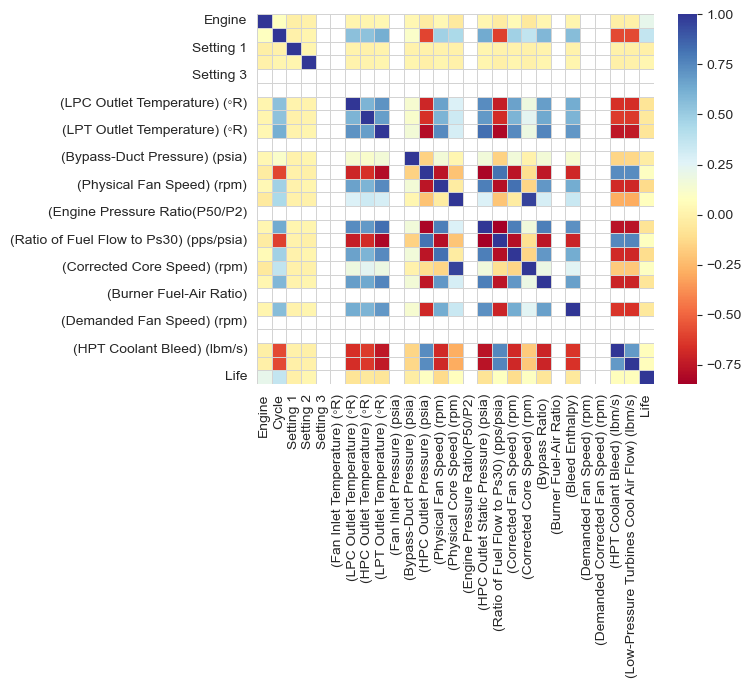

In [43]:
threshold=0.9
mask=train1.where(train_corr>threshold).isna()


sns.heatmap(train_corr,cmap='RdYlBu', linewidths=0.5, linecolor='lightgrey')

In [38]:
train_corr.head(5)

,Engine,Cycle,Setting 1,Setting 2,Setting 3,(Fan Inlet Temperature) (◦R),(LPC Outlet Temperature) (◦R),(HPC Outlet Temperature) (◦R),(LPT Outlet Temperature) (◦R),(Fan Inlet Pressure) (psia),...,(Corrected Fan Speed) (rpm),(Corrected Core Speed) (rpm),(Bypass Ratio),(Burner Fuel-Air Ratio),(Bleed Enthalpy),(Demanded Fan Speed) (rpm),(Demanded Corrected Fan Speed) (rpm),(HPT Coolant Bleed) (lbm/s),(Low-Pressure Turbines Cool Air Flow) (lbm/s),Life
Engine,1.000000,0.078753,-0.017895,-0.006197,NaN,NaN,0.014133,0.012621,0.026116,NaN,...,0.044230,-0.059473,0.022486,NaN,0.013513,NaN,NaN,-0.020589,-0.016465,0.216858
Cycle,0.078753,1.000000,-0.004527,0.016132,NaN,NaN,0.549898,0.543947,0.624577,NaN,...,0.477523,0.370324,0.588676,NaN,0.566995,NaN,NaN,-0.583597,-0.585923,0.363152
Setting 1,-0.017895,-0.004527,1.000000,0.011660,NaN,NaN,0.009030,-0.005651,0.009544,NaN,...,0.002318,-0.004469,0.007652,NaN,0.002599,NaN,NaN,-0.005713,-0.014559,-0.010636
Setting 2,-0.006197,0.016132,0.011660,1.000000,NaN,NaN,0.007266,0.009068,0.014673,NaN,...,0.018156,-0.006310,0.014156,NaN,0.012280,NaN,NaN,-0.010554,-0.007846,0.019530
Setting 3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [45]:
mask.head(5)

,Engine,Cycle,Setting 1,Setting 2,Setting 3,(Fan Inlet Temperature) (◦R),(LPC Outlet Temperature) (◦R),(HPC Outlet Temperature) (◦R),(LPT Outlet Temperature) (◦R),(Fan Inlet Pressure) (psia),...,(Corrected Fan Speed) (rpm),(Corrected Core Speed) (rpm),(Bypass Ratio),(Burner Fuel-Air Ratio),(Bleed Enthalpy),(Demanded Fan Speed) (rpm),(Demanded Corrected Fan Speed) (rpm),(HPT Coolant Bleed) (lbm/s),(Low-Pressure Turbines Cool Air Flow) (lbm/s),Life
0,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
1,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
2,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
3,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
4,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True


In [46]:
train_corr.index

Index(['Engine', 'Cycle', 'Setting 1', 'Setting 2', 'Setting 3',
       '(Fan Inlet Temperature) (◦R)', '(LPC Outlet Temperature) (◦R)',
       '(HPC Outlet Temperature) (◦R)', '(LPT Outlet Temperature) (◦R)',
       '(Fan Inlet Pressure) (psia)', '(Bypass-Duct Pressure) (psia)',
       '(HPC Outlet Pressure) (psia)', '(Physical Fan Speed) (rpm)',
       '(Physical Core Speed) (rpm)', '(Engine Pressure Ratio(P50/P2)',
       '(HPC Outlet Static Pressure) (psia)',
       '(Ratio of Fuel Flow to Ps30) (pps/psia)',
       '(Corrected Fan Speed) (rpm)', '(Corrected Core Speed) (rpm)',
       '(Bypass Ratio) ', '(Burner Fuel-Air Ratio)', '(Bleed Enthalpy)',
       '(Demanded Fan Speed) (rpm)', '(Demanded Corrected Fan Speed) (rpm)',
       '(HPT Coolant Bleed) (lbm/s)',
       '(Low-Pressure Turbines Cool Air Flow) (lbm/s)', 'Life'],
      dtype='object')